# Minerals

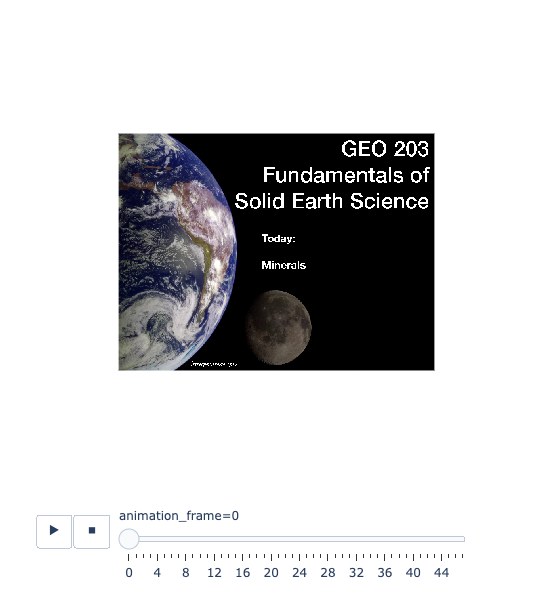

In [1]:
import os,re, IPython
import plotly.express as px
from skimage import io,color
import numpy as np

# Specify folder containing Slides*.png
folder = 'Lecture7_Minerals'

# create list of png files
files = []
for (roots,dirs,file) in os.walk(folder):
    if roots==folder:
        for f in file: 
            if f.endswith('.png') and f.startswith(folder): files.append(f)
files.sort(key=lambda f: int(re.sub('\D','',f))) # sort by number of slide

num_slides = len(files)
for slide, file in enumerate(files):
    image_file = folder+'/'+file
    img = io.imread(image_file)
    if len(img.shape) == 2: img = color.gray2rgb(img) # convert b/w to rgb
    
    #slide_deck.shape (Nimg, y, x) for monochrome. (Nimg, y, x, 3) for RGB color.
    if slide == 0: slide_deck = np.zeros([num_slides,img.shape[0],img.shape[1],img.shape[2]])
    slide_deck[slide] = img
    
fig = px.imshow(slide_deck, animation_frame=0,binary_string=True, 
                binary_format='png', binary_compression_level=3,
                width=img.shape[1], height=img.shape[0])
fig.update_xaxes(showticklabels=False)
fig.update_yaxes(showticklabels=False)
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 2000
fig.show()    